In [ ]:
import numpy as np
import csv
import pandas as pd

__IMPORT FILE__

In [ ]:
dataset = pd.read_csv ('C:\\Users\\Asus\\1301174038\\used_cars.csv')

__DATA EXPLORATION__

In [3]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20001 entries, 0 to 20000
Data columns (total 19 columns):
id              20001 non-null int64
region          20001 non-null int64
region_url      20001 non-null int64
price           20001 non-null int64
year            19989 non-null float64
manufacturer    19296 non-null float64
condition       10849 non-null float64
cylinders       12916 non-null float64
fuel            19928 non-null float64
odometer        17612 non-null float64
title_status    19891 non-null float64
transmission    19811 non-null object
drive           15359 non-null float64
size            6886 non-null float64
type            16342 non-null float64
paint_color     14487 non-null float64
state           19989 non-null float64
lat             18970 non-null object
long            18970 non-null object
dtypes: float64(12), int64(4), object(3)
memory usage: 2.9+ MB


In [4]:
# encode to float for searching correlation
dataset['transmission'] = pd.to_numeric(dataset['transmission'], errors='coerce')

In [5]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

In [6]:
cor = dataset.corr(method='pearson')

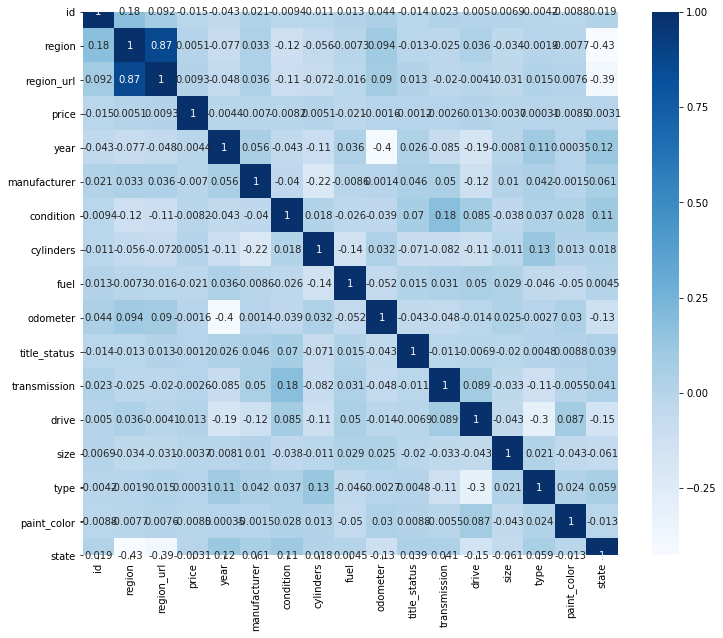

In [7]:
plt.figure(figsize=(12,10))
sns.heatmap(cor, annot=True, cmap=plt.cm.Blues)
plt.show()

In [8]:
cor = dataset.corr(method='pearson')
cor

,id,region,region_url,price,year,manufacturer,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,state
id,1.000000,0.177090,0.091567,-0.015290,-0.042850,0.021341,-0.009375,-0.010796,0.013404,0.043957,-0.014229,0.022756,0.004994,0.006933,-0.004192,-0.008802,0.019421
region,0.177090,1.000000,0.870661,0.005084,-0.076869,0.033092,-0.115785,-0.056473,-0.007310,0.094020,-0.013131,-0.025101,0.035954,-0.034327,-0.001862,-0.007707,-0.426662
region_url,0.091567,0.870661,1.000000,0.009286,-0.047948,0.036348,-0.107000,-0.071603,-0.015980,0.089631,0.012731,-0.020189,-0.004052,-0.031131,0.015417,0.007575,-0.385124
price,-0.015290,0.005084,0.009286,1.000000,-0.004382,-0.006973,-0.008156,0.005056,-0.020611,-0.001608,-0.001215,-0.002586,0.012988,-0.003658,0.000309,-0.008541,-0.003111
year,-0.042850,-0.076869,-0.047948,-0.004382,1.000000,0.056210,-0.043297,-0.108486,0.036203,-0.401415,0.025986,-0.085307,-0.185963,-0.008144,0.108242,0.000351,0.123875
manufacturer,0.021341,0.033092,0.036348,-0.006973,0.056210,1.000000,-0.039894,-0.219000,-0.008609,0.001438,0.046337,0.050383,-0.124212,0.010266,0.041951,-0.001472,0.061185
condition,-0.009375,-0.115785,-0.107000,-0.008156,-0.043297,-0.039894,1.000000,0.017600,-0.026208,-0.039345,0.070480,0.182293,0.085444,-0.037882,0.036792,0.027797,0.113031
cylinders,-0.010796,-0.056473,-0.071603,0.005056,-0.108486,-0.219000,0.017600,1.000000,-0.139918,0.031780,-0.070837,-0.082219,-0.110165,-0.010572,0.128677,0.012604,0.018002
fuel,0.013404,-0.007310,-0.015980,-0.020611,0.036203,-0.008609,-0.026208,-0.139918,1.000000,-0.051662,0.014532,0.030706,0.050400,0.028727,-0.045966,-0.049569,0.004533
odometer,0.043957,0.094020,0.089631,-0.001608,-0.401415,0.001438,-0.039345,0.031780,-0.051662,1.000000,-0.043342,-0.048294,-0.014187,0.025195,-0.002672,0.030365,-0.125251


In [9]:
corr_matrix = dataset.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

to_drop = [column for column in upper.columns if any(upper[column] > 0.05)]
to_drop

['region',
 'region_url',
 'year',
 'manufacturer',
 'condition',
 'cylinders',
 'fuel',
 'odometer',
 'title_status',
 'transmission',
 'drive',
 'type',
 'paint_color',
 'state']

__DATA PREPROCESSING__

In [10]:
data = dataset.drop(columns=(['id','lat','long', 'state', 
                            'region','region_url', 'title_status',
                            'drive', 'paint_color','state','size',
                            'price','year','cylinders','manufacturer',
                             'fuel','odometer','type']), axis= 1)

In [11]:
data.info()
# data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20001 entries, 0 to 20000
Data columns (total 2 columns):
condition       10849 non-null float64
transmission    19810 non-null float64
dtypes: float64(2)
memory usage: 312.6 KB


encode data

In [12]:
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()

data['transmission'] = encoder.fit_transform(data['transmission'])

# data.info()
# data.head()

find missing value

In [13]:
data.isnull().sum()

condition       9152
transmission       0
dtype: int64

fill missing value with the attribute mean

In [14]:
data.fillna(data.mean(), inplace=True)
data.isnull().sum()

condition       0
transmission    0
dtype: int64

encode condition to int, why in here? because nan can not convert to int so, before encode i fill missing value. 

In [15]:
data['condition'] = data['condition'].astype(int)

In [16]:
# data.to_csv('data clustering.csv', index=False)

In [17]:
data.iloc[:, 0:20001]

,condition,transmission
0,0,3
1,0,0
2,0,0
3,0,0
4,1,0
...,...,...
19996,1,0
19997,1,0
19998,1,0
19999,1,0


In [18]:
data.iloc[0,0]

0

__CLUSTERING__

k-Means method

In [19]:
# choose clusters
k = 2

In [20]:
# random centroids sesuai nilai tiap row
c1x = np.random.uniform(min(data['condition']), max(data['condition']))
c1y = np.random.uniform(min(data['transmission']), max(data['transmission']))
c2x = np.random.uniform(min(data['condition']), max(data['condition']))
c2y = np.random.uniform(min(data['transmission']), max(data['transmission']))

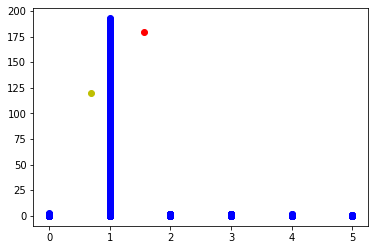

In [21]:
plt.scatter(data['condition'],data['transmission'], color='b')
plt.scatter(c1x, c1y, color='r')
plt.scatter(c2x, c2y, color='y')

Euclidian Distance

In [22]:
import math

In [23]:
def euclid_distance(a, b, cx, cy):
    return round(math.sqrt(math.pow(a - cx, 2) + math.pow(b - cy, 2)),2)

In [ ]:
# while True:
c1=[]
c2=[]
c3=[]
c4=[]

for i in range(len(data)):
    d1 = euclid_distance(data.iloc[i, 0],data.iloc[i, 1],c1x,c1y)
    d2 = euclid_distance(data.iloc[i, 0],data.iloc[i, 1],c2x,c2y)
    data1 = data.iloc[i, :0]
    data2 = data.iloc[i, :1]
    if (d1 < d2):
        c1.append(data1)
        c2.append(data2)
    elif (d2 < d1):
        c3.append(data1)
        c4.append(data2)
# plt.scatter(c1, c2, color='r')
# plt.scatter(c3, c4, color='y')
#     print(c1,c2,c3,c4)

[] [] [Series([], Name: 0, dtype: int64)] [condition    0
Name: 0, dtype: int64]
[] [] [Series([], Name: 0, dtype: int64), Series([], Name: 1, dtype: int64)] [condition    0
Name: 0, dtype: int64, condition    0
Name: 1, dtype: int64]
[] [] [Series([], Name: 0, dtype: int64), Series([], Name: 1, dtype: int64), Series([], Name: 2, dtype: int64)] [condition    0
Name: 0, dtype: int64, condition    0
Name: 1, dtype: int64, condition    0
Name: 2, dtype: int64]
[] [] [Series([], Name: 0, dtype: int64), Series([], Name: 1, dtype: int64), Series([], Name: 2, dtype: int64), Series([], Name: 3, dtype: int64)] [condition    0
Name: 0, dtype: int64, condition    0
Name: 1, dtype: int64, condition    0
Name: 2, dtype: int64, condition    0
Name: 3, dtype: int64]
[] [] [Series([], Name: 0, dtype: int64), Series([], Name: 1, dtype: int64), Series([], Name: 2, dtype: int64), Series([], Name: 3, dtype: int64), Series([], Name: 4, dtype: int64)] [condition    0
Name: 0, dtype: int64, condition    0
Na

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[condition    0
Name: 0, dtype: int64, condition    0
Name: 1, dtype: int64, condition    0
Name: 2, dtype: int64, condition    0
Name: 3, dtype: int64, condition    1
Name: 4, dtype: int64, condition    1
Name: 5, dtype: int64, condition    1
Name: 6, dtype: int64, condition    1
Name: 7, dtype: int64, condition    1
Name: 8, dtype: int64, condition    1
Name: 9, dtype: int64, condition    1
Name: 10, dtype: int64, condition    1
Name: 11, dtype: int64, condition    1
Name: 12, dtype: int64, condition    1
Name: 13, dtype: int64, condition    1
Name: 14, dtype: int64, condition    1
Name: 15, dtype: int64, condition    1
Name: 16, dtype: int64, condition    1
Name: 17, dtype: int64, condition    1
Name: 18, dtype: int64, condition    1
Name: 19, dtype: int64, condition    1
Name: 20, dtype: int64, condition    0
Name: 21, dtype: int64, condition    2
Name: 22, dtype: int64, condition    1
Name: 23, dtype: int64, condition    2
Name: 24, dtype: int64, condition    1
Name: 25, dtype: in

In [56]:
c1 = np.sum(c1) / len(c1)
c1

0.0